# Chair Stable Diffusion text encoder training

Amos Dinh, 5504890, WWI21DSA, 21.06.2024

The idea is to train a stable diffusion model using https://github.com/kohya-ss/sd-scripts.
There can be multiple images of the same chair (front, back) as well as the same chair in different colors present.

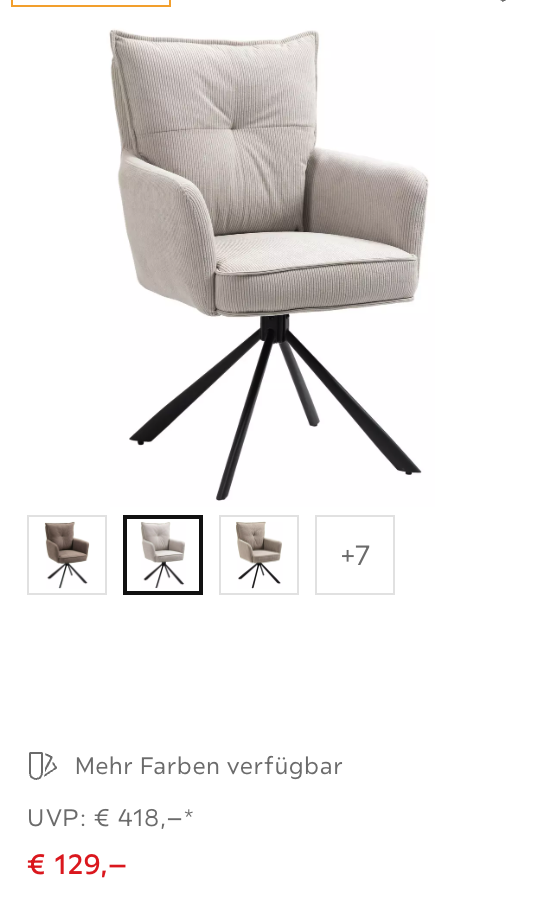

We further scrape for product details to add as textual conditioning tokens for training:

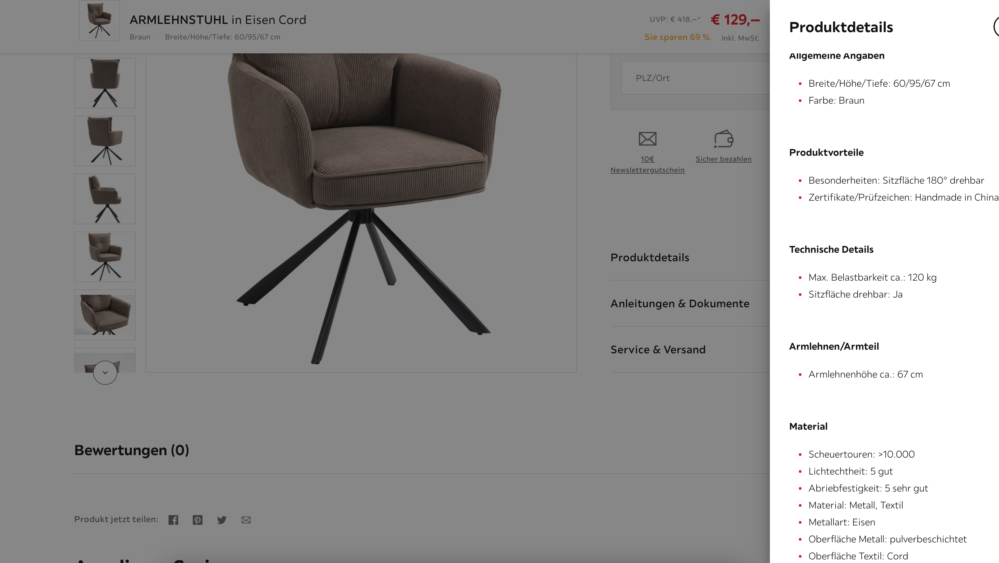

Further we can scrape the price. There is also the option to rate a product. However, ratings are only sparsely available such that we ignore them.


## Crawling

In [ ]:
import os
import urllib.request
import uuid
import time
from playwright.sync_api import Playwright, sync_playwright
import datetime

class GermanChairWebsiteSpider:
    def __init__(self):
        self.start_url = 'https://www.GermanChairWebsite.de/stuehle-C12C1'
        self.image_directory = 'images'
        os.makedirs(self.image_directory, exist_ok=True)
        self.image_count = 0

    def download_image(self, image_url, filename):
        """
        Downloads the image from the given URL and saves it to the specified
        file. Returns True if the operation is successful, False otherwise.
        """
        try:
            urllib.request.urlretrieve(image_url, filename)
            return True
        except urllib.error.HTTPError as e:
            # If the server returns a 403 Forbidden error, try to bypass it using
            # one of several strategies
            if e.code == 403:
                # Option 1: Set a custom User-Agent header
                headers = {'User-Agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/58.0.3029.110 Safari/537.3'}
                opener = urllib.request.build_opener()
                opener.addheaders = headers.items()
                urllib.request.install_opener(opener)
                urllib.request.urlretrieve(image_url, filename)
                return True

            # If none of the strategies work, log the error and return False
            print(f'Error downloading image: {e}')
            return False
            
    def get_save_csv_set(self, a=None):
        # if a is not None, save set a to csv file
        if a is not None:
            with open('GermanChairWebsite.csv', 'w') as f:
                for item in a:
                    f.write("%s\n" % item)
        # read csv file and return set
        with open('GermanChairWebsite.csv', 'r') as f:
            a = set()
            for line in f:
                a.add(line.strip())
        
        return a
    
   
    
    def download_images_of_parent(self, parent, filename_prefix):
        for i, image_url_element in enumerate(parent.query_selector_all('img[srcset]')):
            # image_url = image_url_element.get_attribute('srcset').strip()
            image_url = image_url_element.get_attribute('src').strip()
            filename = f'{filename_prefix}_{i+1}.jpg'
            if image_url not in self.a:
                self.a.add(image_url)
                self.get_save_csv_set(self.a)
                success = self.download_image(image_url, os.path.join(self.image_directory, filename))
                if success:
                    self.image_count += 1
                
                print(f'Download {image_url}')


    def run(self):
        with sync_playwright() as p:
            browser = p.firefox.launch(headless=True)
            context = browser.new_context()
            page = context.new_page()
            headers = {'User-Agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/58.0.3029.110 Safari/537.3'}
            page.set_extra_http_headers(headers)
            page.goto(self.start_url)
            page.wait_for_selector('button[data-purpose="cookieBar.button.accept"]').click()
            self.a = self.get_save_csv_set()
            last_pos = 0

            with open('urls.csv', 'w') as f:
                f.write('url,uuid,price\n')
            url_file = open('urls.csv', 'a')

            while True:
                product_elements = page.query_selector_all('article')

                for i, product in enumerate(product_elements[last_pos:]):
                    last_pos+=1
                    price_parent = product.query_selector('div[data-testid="productCard.preview"]')
                    parent_more_options = product.query_selector('div > ul')
                    product_url = 'https://www.GermanChairWebsite.de'+product.query_selector("a").get_attribute('href')

                    unique_uuid = uuid.uuid5(uuid.NAMESPACE_URL, product_url)

                    
                    price=None
                    if price_parent:
                       
                        price_element = product.query_selector('div[data-purpose="product.price.current"]')
                        if price_element:
                            price = price_element.inner_text().replace('€', '').replace(',', '.').replace('\u202f', '').strip()
                            if not price:
                                price = product.query_selector('sup').inner_text()
                            filename_prefix = f'{unique_uuid}_{price}'
                            
                            self.download_images_of_parent(price_parent, filename_prefix)
                            if parent_more_options:
                                self.download_images_of_parent(parent_more_options, filename_prefix)

                    if price is None:
                        price = ''
                    url_file.write(f'{product_url},{unique_uuid},{price}\n')
                    url_file.flush()             

              
                load_more_button = page.query_selector('button[data-purpose="listing.loadMore.next.button"]')
                if not load_more_button:
                    break
                load_more_button.click()
                time.sleep(3) # wait for 1 second before scraping the new data

            browser.close()

        print(f'Scraped {self.image_count} images.')
      


    def run_get_tags(self):
        with sync_playwright() as p:
            browser = p.firefox.launch(headless=True)
            context = browser.new_context()
            page = context.new_page()
            headers = {'User-Agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/58.0.3029.110 Safari/537.3'}
            page.set_extra_http_headers(headers)
            page.goto(self.start_url)
            page.wait_for_selector('button[data-purpose="cookieBar.button.accept"]').click()

            with open('tags.csv', 'w') as f:
                f.write('url,uuid,tags\n')
            tags_file = open('tags.csv', 'a')

            with open('urls.csv', 'r') as f:
                url_data = f.readlines()
            urls = [x.split(',')[0] for x in url_data]
            urls = urls[1:]
            urls = list(set(urls))
            unique_uuids = [uuid.uuid5(uuid.NAMESPACE_URL, x) for x in urls]
            for i, (id, url) in enumerate(zip(unique_uuids, urls)):
                page.goto(url)
                page.click('text=Produktdetails')
           
                modal_sidebar_lis = page.query_selector_all('section[data-purpose="modal.body"]>ul>li')
                all_tags = ''
                for li in modal_sidebar_lis:
                    heading = li.query_selector('div').inner_text()
                    tags = ['||'+heading+'||'+x.inner_text() for x in li.query_selector_all('li')]
                    all_tags += '&&&'.join(tags)

                tags_file.write(f'{url},{id},{all_tags}\n')
                tags_file.flush()
         
            browser.close()

        print(f'Scraped {self.image_count} images.')

if __name__ == '__main__':
    spider = GermanChairWebsiteSpider()
    spider.run()
    spider.run_get_tags()

## Training data preparation
### Filtering Images
We ask llava phi model to count the number of chairs, and only keep those with exactly one chair in the picture.


In [ ]:
image_groups = {}
for image in os.listdir('images'):
    parts = image.split('_')
    if len(parts) > 1:
        base_name = '_'.join(parts[:-1])
        if base_name not in image_groups:
            image_groups[base_name] = []
        image_groups[base_name].append(image)

for base_name, group in image_groups.items():
    group.sort(key=lambda x: int(x.split('_')[-1].split('.')[0]))

from mlx_vlm import load, generate

model_path = "mlx-community/llava-phi-3-mini-4bit"
# model_path = 'mlx-community/nanoLLaVA'
model, processor = load(model_path)


def count_chairs_in_image(image_path):
    prompt = processor.tokenizer.apply_chat_template(
        [{"role": "user", "content": f"<image>\nPrecisely count the number of chairs. Answer only with the literal number"}],
        tokenize=False,
        add_generation_prompt=True,
    )

    output = generate(model, processor, image_path, prompt)
    
    return int(output.strip())


from tqdm import tqdm
if not os.path.exists('images_filtered'):
    os.makedirs('images_filtered')
for base_name, group in tqdm(image_groups.items(), desc='Filtering Images'):

    if os.path.exists(f'images_filtered/{group[0]}'):
        continue

    try:
        chair_count = count_chairs_in_image(f'images/{group[0]}')
        if chair_count > 1:
            continue 
        
        if len(group) > 1:
            chair_count = count_chairs_in_image(f'images/{group[1]}')
            if chair_count > 1:
                continue 
    
        for image in group:
            os.system(f'cp images/{image} images_filtered/{image}')

    except Exception as e: 
        print(e)
        continue



Fetching 9 files:   0%|          | 0/9 [00:00<?, ?it/s]

Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.
Filtering Images: 100%|██████████| 5328/5328 [4:10:45<00:00,  2.82s/it]  


Although the llava phi3 model is only 3 billion parameters it performs better than the llava1.6/ llava-next model (7b) on this simple counting task. Paligemma (Google) is too slow.

Automatic and following manual filtering  reduces the images from 10500 to 6500

### Resizing and padding

In [ ]:
# resize images to 512x512, fill white aspact ratio
# adapted from https://stackoverflow.com/a/44371790/9549296

import cv2
import os
from PIL import Image
import numpy as np

images = os.listdir('images_filtered')
os.makedirs('images_resized2', exist_ok=True)
for image in tqdm(images):
    if os.path.exists(f'images_resized2/{image}'):
        continue
    try:
        img = cv2.imread(f'images/{image}')
        h, w, _ = img.shape
        if h > w:
            new_img = cv2.resize(img, (512, int(512*h/w)))
        else:
            new_img = cv2.resize(img, (int(512*w/h), 512))

        if h > w:
            new_img = np.ones((h, h, 3), dtype=np.uint8) * 255
            new_img[:, (h-w)//2:(h-w)//2+w] = img
        else:
            new_img = np.ones((w, w, 3), dtype=np.uint8) * 255
            new_img[(w-h)//2:(w-h)//2+h, :] = img
        
        new_img = cv2.resize(new_img, (512, 512))
        
        cv2.imwrite(f'images_resized2/{image}', new_img)
    except Exception as e:
        # print(e)
        continue

100%|██████████| 6358/6358 [00:00<00:00, 79152.61it/s]


### Preparing tags

The tags are scraped from the site as mentioned above. As such it will be interesting to see how well the model handles german tag-words.

In [ ]:
import pandas as pd 
tags = pd.read_csv('tags.csv')

In [4]:

def process_tags(s):
    tag_string = '||'.join(s.split('&&&')).replace('||||','||').replace(' ca.','').replace('ca.','').replace(' cm','cm').replace(' kg','kg').replace('°','grad').replace(':','')
    new_tag_string = ''
    new_tag_string = ''
    for i in range(len(tag_string)):
        if i > 0 and i < len(tag_string) - 1 and tag_string[i-1].isdigit() and tag_string[i+1].isdigit():
            new_tag_string += tag_string[i].replace(',', '.') 
        else:
            new_tag_string += tag_string[i] + ''
    tag_string = new_tag_string.strip()

    tag_split = tag_string.split('||') 
    tag_split = [x for x in tag_split if x]

    actual_tags = []
    for i in range(0, len(tag_split), 2):
        
        try:
            actual_tag = tag_split[i+1]
        except:
            actual_tags.append(tag_split[i])
            continue

        if 'Breite/Höhe/Tiefe' in actual_tag:
            sizes = actual_tag.split(' ')[-1].split('/')
            if 'cm' in sizes[-1]:
                scale = 'cm'
            elif 'mm' in sizes[-1]:
                scale = 'mm'
            elif 'm' in sizes[-1]:
                scale = 'm'
            actual_tags.append(tag_split[i]+' '+'Breite: '+sizes[0]+scale)
            actual_tags.append(tag_split[i]+' '+'Höhe: '+sizes[1]+scale)
            actual_tags.append(tag_split[i]+' '+'Tiefe: '+sizes[2])
        elif '(Länge/Breite/Höhe)' in actual_tag and 'Paket 1' in actual_tag:
            sizes = actual_tag.split(' (Länge/Breite/Höhe)')[-2].split(' ')[-1].split('/')
            if 'cm' in sizes[-1]:
                scale = 'cm'
            elif 'mm' in sizes[-1]:
                scale = 'mm'
            elif 'm' in sizes[-1]:
                scale = 'm'
            actual_tags.append(tag_split[i]+' '+'Paket 1 Länge: '+sizes[0]+scale)
            actual_tags.append(tag_split[i]+' '+'Paket 1 Breite: '+sizes[1]+scale)
            actual_tags.append(tag_split[i]+' '+'Paket 1 Höhe: '+sizes[2])
        elif 'Paket 2' in actual_tag and '(Länge/Breite/Höhe)' in actual_tag:
            sizes = actual_tag.split(' (Länge/Breite/Höhe)')[-2].split(' ')[-1].split('/')
            if 'cm' in sizes[-1]:
                scale = 'cm'
            elif 'mm' in sizes[-1]:
                scale = 'mm'
            elif 'm' in sizes[-1]:
                scale = 'm'
            actual_tags.append(tag_split[i]+' '+'Paket 2 Länge: '+sizes[0]+scale)
            actual_tags.append(tag_split[i]+' '+'Paket 2 Breite: '+sizes[1]+scale)
            actual_tags.append(tag_split[i]+' '+'Paket 2 Höhe: '+sizes[2])
        elif 'Paket 3' in actual_tag and '(Länge/Breite/Höhe)' in actual_tag:
            sizes = actual_tag.split(' (Länge/Breite/Höhe)')[-2].split(' ')[-1].split('/')
            if 'cm' in sizes[-1]:
                scale = 'cm'
            elif 'mm' in sizes[-1]:
                scale = 'mm'
            elif 'm' in sizes[-1]:
                scale = 'm'
            actual_tags.append(tag_split[i]+' '+'Paket 3 Länge: '+sizes[0]+scale)
            actual_tags.append(tag_split[i]+' '+'Paket 3 Breite: '+sizes[1]+scale)
            actual_tags.append(tag_split[i]+' '+'Paket 3 Höhe: '+sizes[2])
        elif 'Farbe' in actual_tag:
            for tag in actual_tag.split(','):
                actual_tags.append(tag_split[i]+' Farbe '+tag.replace('Farbe',''))
        else:
            for tag in actual_tag.split(','):
                actual_tags.append(tag_split[i]+' '+tag)

    actual_tags
    # remove a word if it repeats like : "Material Material"
    actual_tags_no_word_repeat = []
    for tag in actual_tags:
        new_tag = ''
        last_word = ''
        for word in tag.split():
            if word != last_word:
                new_tag += word + ' '
                last_word = word
        actual_tags_no_word_repeat.append(new_tag.strip())

    return actual_tags_no_word_repeat
        
process_tags(tags.iloc[3000]['tags'])

['Allgemeine Angaben Breite: 67cm',
 'Allgemeine Angaben Höhe: 85cm',
 'Allgemeine Angaben Tiefe: 60cm',
 'Allgemeine Angaben Farbe Schwarz',
 'Allgemeine Angaben Farbe Mokka',
 'Allgemeine Angaben Kollektionsname TAMINA',
 'Produktvorteile Besonderheiten Lederauswahl',
 'Produktvorteile Stoffauswahl',
 'Produktvorteile Typenauswahl',
 'Produktvorteile inklusive Armlehnen',
 'Produktvorteile Gestellauswahl',
 'Technische Details Max. Belastbarkeit 140kg',
 'Armlehnen/Armteil Armlehnenhöhe 68cm',
 'Material Scheuertouren 30.000',
 'Material Lichtechtheit 4 ziemlich gut',
 'Material Abriebfestigkeit 4 gut',
 'Material Pillingbildung 4 leicht',
 'Material Textil',
 'Material Oberfläche Textil Mikrofaser',
 'Material Materialzusammensetzung 100 % Polyester',
 'Beine Metallart Eisen',
 'Beine Oberfläche Metall lackiert',
 'Beine Farbe Schwarz',
 'Beine Anzahl der Beine 4',
 'Beine Beinform eckig',
 'Beine Flachrohr',
 'Beine Material Metall',
 'Sitzfläche Sitzbreite 62cm',
 'Sitzfläche Sitz

In [8]:
from tqdm.auto import tqdm 
import os
import unicodedata
import re

def replace_unicode_with_ascii(text):
    """
    Replace Unicode characters in the given text with their ASCII equivalents.
    If an ASCII equivalent is not available, the character is removed.
    """
    normalized_text = unicodedata.normalize('NFKD', text)
    ascii_bytes = normalized_text.encode('ascii', 'ignore')
    ascii_text = ascii_bytes.decode('ascii')
    
    return ascii_text



max_len = 0
tags_dict = {}
mean_len = 0 
counter = 0
for i, row in tags.iterrows():
    if pd.isna(row['tags']):
        continue
    curr_len = len(' '.join(process_tags(row['tags'])).split(' '))
    if curr_len > max_len:
        max_len = curr_len
    mean_len += curr_len
    counter += 1
    the_tags = process_tags(row['tags']) 
    while curr_len > 219: # maximum clip length (its 225) - start and end token, make 4 less to make sure it fits (lenght is actually 75, and clip is called 3 times, results are concatenated, so 75*3=225)
    # remove last tags of the chairs as they are usually not the most important (e.g. Shipping dimensions of packages (info is already given in the dimensions of the chair))
        the_tags = the_tags[:-1]
        curr_len = len(' '.join(the_tags).split(' '))

    tags_dict[row['uuid']] = ', '.join(the_tags)

print('max_len:', max_len)
print('mean_len:', mean_len/counter)
os.makedirs('images_tags_final', exist_ok=True)
counter = 0
for img in tqdm(os.listdir('images_filtered')):
    img_old = img
    uuid = img.split('_')[0]
    if uuid in tags_dict:
        counter+=1
        img = img.replace('‒','')
        with open(f'images_tags_final/{img.replace(".jpg","")}.txt', 'w') as file:
            mytags = tags_dict[uuid] 
            price_string = img.split('_')[-2].replace('.‒','.00') 
            if price_string.count('.') > 1:
                price_string = price_string.replace('.', '', 1)
                
            price = str(int(round(float(price_string))))
            mytags = f'Preis {price}, {mytags}'.replace('Ä', 'Ae').replace('ä', 'ae').replace('Ö', 'Oe').replace('ö', 'oe').replace('Ü', 'Ue').replace('ü', 'ue').replace('ß', 'ss')
            mytags = replace_unicode_with_ascii(mytags)
            file.write(mytags)
        # copy image to new folder
        
        os.system(f'cp images_filtered/{img_old} images_tags_final/{img}')
counter

import os

folder_path = 'images_tags_final'
for file_name in os.listdir(folder_path):
    if file_name.endswith('.txt'):
        file_path = os.path.join(folder_path, file_name)
        text = open(file_path, 'r').read()
        text = replace_unicode_with_ascii(text)
        with open(file_path, 'w') as file:
            file.write(text)
        


/Users/amos/miniconda3/envs/sd-scripts/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


max_len: 271
mean_len: 100.12443194113828


100%|██████████| 6358/6358 [00:15<00:00, 404.51it/s]


In [9]:
import os 

image_dir = './images_tags_final'


metadata_file = 'C:\piyo\piyo_md.json'
resolution = 512
batch_size = 2
epochs = 5
max_bucket_reso = 512
use_mixed_precision = 'fp16'
lr = 5e-6
train_steps = 10000
flip_aug = True
toml = f"""[general]
shuffle_caption = true
caption_extension = '.txt'
keep_tokens = 1

[[datasets]]
resolution = [{resolution}, {resolution}]
batch_size = {batch_size}
enable_bucket= true
# max_bucket_reso = 1024
# min_bucket_reso = 128
# bucket_reso_steps = 64

    [[datasets.subsets]]
    image_dir = '{image_dir}'
    metadata_file = '{image_dir}'
    keep_tokens = 1
    flip_aug = true
    num_repeats = {epochs}
    

"""
# check if image_dir exists
if not os.path.exists(image_dir):
    raise Exception(f"Image directory {image_dir} does not exist")
# make it full path
image_dir = os.path.abspath(image_dir)

with open('dataset_config.toml', 'w') as f:
    f.write(toml)

dataset_toml = os.path.abspath('dataset_config.toml')

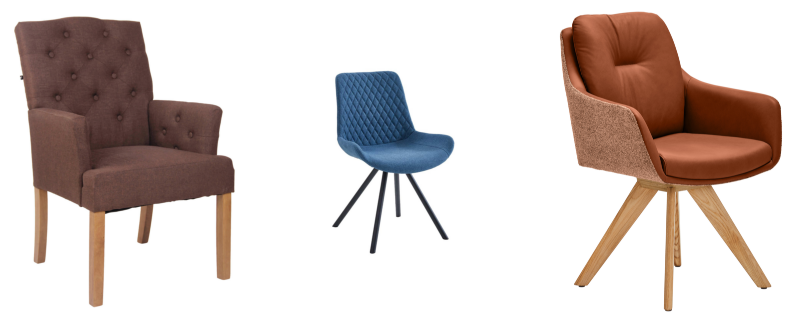

In [14]:
# Sample prompts
training_sample_prompts = """
Preis 150, Allgemeine Angaben Breite: 66cm, Allgemeine Angaben Hoehe: 98cm, Allgemeine Angaben Tiefe: 66cm, Allgemeine Angaben Gewicht 11kg, Allgemeine Angaben Farbe Dunkelgrau, Technische Details Max. Belastbarkeit 136kg, Produktmerkmale Rueckenlehne Hoehe 49cm, Armlehnen/Armteil Armlehnenhoehe 18cm, Bezug Material Textil, Material Textil, Material Oberflaeche Textil Textilgeflecht, Kundenhinweise Pflegehinweise Keine scharfen Reinigungsmittel verwenden --w 512 --h 512 --d 1 --l 7.5 --s 28

Preis 370, Allgemeine Angaben Breite: 56cm, Allgemeine Angaben Hoehe: 86cm, Allgemeine Angaben Tiefe: 59cm, Allgemeine Angaben Gewicht 15kg, Allgemeine Angaben Farbe Braun, Artikel besteht aus Anzahl der Stuehle 2, Technische Details Anzahl der Sitzplaetze 1, Produktmerkmale Bezug Stoffzusammensetzung 100% Polyester, Material Holzwerkstoff --w 512 --h 512 --d 1 --l 7.5 --s 28

Preis 499, Allgemeine Angaben Breite: 62cm, Allgemeine Angaben Hoehe: 90cm, Allgemeine Angaben Tiefe: 65cm, Allgemeine Angaben Farbe Haselnussfarben, Allgemeine Angaben Farbe Cognac, Allgemeine Angaben Farbe Wildeiche, Produktvorteile Zubehoer inklusive Armlehnen, Produktvorteile Gestell, Produktvorteile Besonderheiten Lederauswahl, Produktvorteile Stoffauswahl, Produktvorteile Typenauswahl, Produktvorteile inklusive Armlehnen, Produktvorteile Gestellauswahl, Artikel besteht aus Anzahl der Rueckenkissen 1, Artikel besteht aus Rueckenkissen, Technische Details Max. Belastbarkeit 140kg, Armlehnen/Armteil Armlehnenhoehe 66cm, Material Oberflaeche geoelt, Material Lederart Kombination Echtleder/Stoff, Material Lederqualitaet Rindleder, Material Holzart Eiche, Material Holzqualitaet Echtholz, Material Echtholz massiv, Material Scheuertouren 50.000, Material Oberflaeche Leder pigmentiert, Material Lichtechtheit 5 gut, Material Abriebfestigkeit 4 gut, Material Pillingbildung 4 leicht, Material Holz, Material Textil, Material Leder, Material Oberflaeche Textil Webstoff, Material Materialzusammensetzung 100 % Polyester, Beine Farbe Eiche Bianco, Beine Anzahl der Beine 4, Beine Beinform konisch, Beine Stativgestell, Sitzflaeche Sitzbreite 42-47cm, Sitzflaeche Sitzhoehe 48cm, Sitzflaeche Sitztiefe 42cm, Innenleben Rueckenlehne Schaumstoff, Innenleben Schaumstoff, Kundenhinweise Verwendung Indoor, Kundenhinweise Lieferhinweis fuer Endkunden zerlegt, Kundenhinweise Jedes Echtholzprodukt ist ein Unikat. Woelbungen, Kundenhinweise Farbverlaeufe etc. sind warentypisch und stellen keinen Reklamationsgrund dar., Kundenhinweise Transporthinweis fuer Endkunden Kombi, Kundenhinweise Montagehinweis fuer Endkunden handwerkliche Begabung, Kundenhinweise Pflegehinweise Holzpflegemittel verwenden, Kundenhinweise Lederpflegemittel verwenden, Kundenhinweise nebelfeucht wischen, Verpackungsmasse Anzahl der Pakete 2, Verpackungsmasse Paket 1 Laenge: 65cm, Verpackungsmasse Paket 1 Breite: 65cm, Verpackungsmasse Paket 1 Hoehe: 76cm, Verpackungsmasse Paket 2 Laenge: 56cm, Verpackungsmasse Paket 2 Breite: 51cm --w 512 --h 512 --d 1 --l 7.5 --s 28
"""
# d is random seed, l classifier free guidance, s number of steps

from PIL import Image
import matplotlib.pyplot as plt

image_paths = [
    'images_tags_final/fff852e4-140f-53d4-a9be-7f4c6558abf0_149.90_2.jpg',
    'images_tags_final/fa257c34-6d93-5f57-9b2c-579d8b59890f_369.95_2.jpg',
    'images_tags_final/de28ad4c-0927-5ebd-b31c-2636420ac44a_499._1.jpg'
]

fig, axs = plt.subplots(1, len(image_paths), figsize=(10, 5))

for i, path in enumerate(image_paths):
    img = Image.open(path)
    axs[i].imshow(img)
    axs[i].axis('off')

plt.show()


### Prepare kohya sd-script specific setup


In [ ]:
import os 

!git clone https://github.com/kohya-ss/sd-scripts
# if mps is available, install those requirements
if torch.backends.mps.is_available():
    print('Macbook installation')
    !git clone --recursive https://github.com/bmaltais/kohya_ss
    os.chdir('kohya_ss')
    !pip install xformers bitsandbytes==0.41.1
    !pip install tensorflow-macos tensorflow-metal tensorboard==2.14.1
    !pip install onnxruntime==1.17.1
    !pip install -r requirements.txt
    os.chdir('..')
    # fix for xformers macos https://github.com/bmaltais/kohya_ss/issues/2071
    !ls /Users/amos/miniconda3/envs/sd-scripts/lib/python3.10/site-packages
    !rm -r /Users/amos/miniconda3/envs/sd-scripts/lib/python3.10/site-packages/xformers
    !rm -r /Users/amos/miniconda3/envs/sd-scripts/lib/python3.10/site-packages/xformers-0.0.26.post1.dist-info
else: 
    
    os.chdir('sd-scripts')
    !pip install -r requirements.txt
    os.chdir('..')

In [ ]:
# change directory to the sd-scripts folder
os.chdir('sd-scripts')
# make training_metadata_tags.json file 
!
command = f"python finetune/merge_dd_tags_to_metadata.py --full_path {image_dir} meta_cap.json"
os.system(command)

!python finetune/clean_captions_and_tags.py meta_cap.json meta_cap_clean.json
os.chdir('..')

metadata_file_path = os.path.abspath('sd-scripts/meta_cap_clean.json')

## Training
Only the UNet is finetuned by default, the text encoder is left as-is.
The base model used is https://huggingface.co/runwayml/stable-diffusion-v1-5.

In [ ]:
from huggingface_hub import hf_hub_download
import os
# import shutil

model = hf_hub_download(repo_id="runwayml/stable-diffusion-v1-5", filename="v1-5-pruned.safetensors" )
model_path = os.path.abspath(model)


v1-5-pruned.safetensors: 100%|██████████| 7.70G/7.70G [04:02<00:00, 31.7MB/s]


In [ ]:
!pip install torch==2.1.2 torchvision # fix "torch has no attribute mps"

In [23]:
model = '/Users/amos/Programming/Studium/AIML/Chairs/downloaded_models/v1-5-pruned.safetensors'

In [32]:
# precompute latents (using encoder of the default model)
metadata_file_path = os.path.abspath('sd-scripts/meta_cap_clean.json')

os.chdir('sd-scripts')
command = f'python finetune/prepare_buckets_latents.py {"--flip_aug" if flip_aug else ""} --full_path {image_dir} {metadata_file_path} meta_cap_buckets.json "{model}" --batch_size {batch_size} --max_resolution {max_bucket_reso},{max_bucket_reso} --mixed_precision {use_mixed_precision} --max_data_loader_n_workers=4'
os.system(command)
os.chdir('..')
metadata_file_path = os.path.abspath('sd-scripts/meta_cap_buckets.json')

get_preferred_device() -> mps


2024-06-13 17:59:42 INFO     found 5234 images.    ]8;id=667413;file:///Users/amos/Programming/Studium/AIML/Chairs/sd-scripts/finetune/prepare_buckets_latents.py\prepare_buckets_latents.py]8;;\:]8;id=809653;file:///Users/amos/Programming/Studium/AIML/Chairs/sd-scripts/finetune/prepare_buckets_latents.py#70\70]8;;\
                    INFO     loading existing      ]8;id=80163;file:///Users/amos/Programming/Studium/AIML/Chairs/sd-scripts/finetune/prepare_buckets_latents.py\prepare_buckets_latents.py]8;;\:]8;id=779315;file:///Users/amos/Programming/Studium/AIML/Chairs/sd-scripts/finetune/prepare_buckets_latents.py#73\73]8;;\
                             metadata:                                          
                             /Users/amos/Programmi                              
                             ng/Studium/AIML/Chair                              
                             s/sd-scripts/meta_cap                              
                             

get_preferred_device() -> mps
get_preferred_device() -> mps
get_preferred_device() -> mps
get_preferred_device() -> mps


100%|██████████| 5234/5234 [1:00:10<00:00,  1.45it/s]
2024-06-13 18:59:57 INFO     bucket 0 (320, 704): ]8;id=666699;file:///Users/amos/Programming/Studium/AIML/Chairs/sd-scripts/finetune/prepare_buckets_latents.py\prepare_buckets_latents.py]8;;\:]8;id=336184;file:///Users/amos/Programming/Studium/AIML/Chairs/sd-scripts/finetune/prepare_buckets_latents.py#194\194]8;;\
                             147                                                
                    INFO     bucket 1 (320, 768): ]8;id=801803;file:///Users/amos/Programming/Studium/AIML/Chairs/sd-scripts/finetune/prepare_buckets_latents.py\prepare_buckets_latents.py]8;;\:]8;id=924570;file:///Users/amos/Programming/Studium/AIML/Chairs/sd-scripts/finetune/prepare_buckets_latents.py#194\194]8;;\
                             10                                                 
                    INFO     bucket 2 (384, 640): ]8;id=99088;file:///Users/amos/Programming/Studium/AIML/Chairs/sd-scripts/finetune/

In [ ]:
# this code is adapted from https://github.com/Linaqruf/kohya-trainer/blob/main/kohya-LoRA-finetuner.ipynb
import datetime
import toml
import os
import torch
      
%store -r
 
dataset_repeats = 4 #
output_dir = 'checkpoints'
resume_path = None
os.makedirs(output_dir, exist_ok=True)

output_filename = f"chair_{datetime.datetime.now().strftime('%Y-%m-%d_%H-%M-%S')}"

enable_sample_prompt = True  # @param {type:"boolean"}
sampler = "ddim"  # @param ["ddim", "pndm", "lms", "euler", "euler_a", "heun", "dpm_2", "dpm_2_a", "dpmsolver","dpmsolver++", "dpmsingle", "k_lms", "k_euler", "k_euler_a", "k_dpm_2", "k_dpm_2_a"]
noise_offset = 0.0  # @param {type:"number"}
# max_train_steps = 10000  # @param {type:"number"}

train_batch_size = 1  # @param {type:"number"}
mixed_precision = "no"  # @param ["no","fp16","bf16"] {allow-input: false}
# save_state = False  # @param {type:"boolean"}
save_precision = "fp16"  # @param ["float", "fp16", "bf16"] {allow-input: false}
save_n_epoch_ratio = 1  # @param {type:"number"}
save_model_as = "ckpt"  # @param ["ckpt", "safetensors", "diffusers", "diffusers_safetensors"] {allow-input: false}
max_token_length = 225  # @param {type:"number"}
clip_skip = 2  # @param {type:"number"}
gradient_checkpointing = True  # @param {type:"boolean"}
gradient_accumulation_steps = 1  # @param {type:"number"}
seed = -1  # @param {type:"number"}
logging_dir = "fine_tune/logs"
prior_loss_weight = 1.0

config = {
    "model_arguments": {
        "v2": False,
        # "v_parameterization": v_parameterization if v2 and v_parameterization else False,
        "v_parameterization": False,
        "pretrained_model_name_or_path": model_path,
        # "vae": vae,
    },
    "optimizer_arguments": {
        # "min_snr_gamma": min_snr_gamma if not min_snr_gamma == -1 else None,
        "optimizer_type": 'AdamW8bit',
        "learning_rate": lr,
        # "max_grad_norm": 1.0,
        # "train_text_encoder": train_text_encoder,
        # "optimizer_args": eval(optimizer_args) if optimizer_args else None,
        # "lr_scheduler": lr_scheduler,
        # "lr_warmup_steps": lr_warmup_steps,
        # "lr_scheduler_num_cycles": lr_scheduler_num_cycles if lr_scheduler == "cosine_with_restarts" else None,
        # "lr_scheduler_power": lr_scheduler_power if lr_scheduler == "polynomial" else None,
    },
    "dataset_arguments": {
        "debug_dataset": False,
        "in_json": metadata_file_path,
        "train_data_dir": image_dir,
        "dataset_repeats": dataset_repeats,
        "shuffle_caption": True,
        # "keep_tokens": keep_tokens, # ?
        "resolution": f"{resolution},{resolution}",
        "caption_dropout_rate": 0,
        "caption_tag_dropout_rate": 0,
        "caption_dropout_every_n_epochs": 0,
        "color_aug": False,
        "face_crop_aug_range": None,
        "token_warmup_min": 1,
        "token_warmup_step": 0,
    },
    "training_arguments": {
        "output_dir": output_dir,
        "output_name": output_filename,
        "save_precision": save_precision,
        "save_every_n_epochs": None,
        "save_n_epoch_ratio": save_n_epoch_ratio,
        "save_last_n_epochs": None,
        # "save_state": save_state,
        "save_last_n_epochs_state": None,
        "resume": resume_path,
        "train_batch_size": train_batch_size,
        "max_token_length": 225,
        "mem_eff_attn": False,
        "xformers": True if not torch.backends.mps.is_available() else False,
        # "max_train_steps": max_train_steps, 
        "max_data_loader_n_workers": 8,
        "persistent_data_loader_workers": True,
        "seed": seed if seed > 0 else None,
        "gradient_checkpointing": gradient_checkpointing,
        "gradient_accumulation_steps": gradient_accumulation_steps,
        "mixed_precision": mixed_precision,
        # "clip_skip": clip_skip if not v2 else None,
        "logging_dir": logging_dir,
        "log_prefix": output_filename,
        "noise_offset": noise_offset if noise_offset > 0 else None,
    },
    "sample_prompt_arguments": {
        "sample_every_n_steps": 100 if enable_sample_prompt else 999999,
        "sample_every_n_epochs": None,
        "sample_sampler": sampler,
    },
    "saving_arguments": {
        "save_model_as": save_model_as
    },
}

config_path = os.path.abspath("config_file.toml")
prompt_path = os.path.abspath("sample_prompt.txt")

for key in config:
    if isinstance(config[key], dict):
        for sub_key in config[key]:
            if config[key][sub_key] == "":
                config[key][sub_key] = None
    elif config[key] == "":
        config[key] = None

config_str = toml.dumps(config)

def write_file(filename, contents):
    with open(filename, "w") as f:
        f.write(contents)

write_file(config_path, config_str)
write_file(prompt_path, training_sample_prompts)

print(config_str)

In [ ]:
import datetime 

accelerate_config = 'accelerate_config.toml'
accelerate_config = os.path.abspath(accelerate_config)
from accelerate.utils import write_basic_config

if not os.path.exists(accelerate_config):
    write_basic_config(save_location=accelerate_config)

output_dir = 'checkpoints'
os.makedirs(output_dir, exist_ok=True)
output_filename = f"chair_{datetime.datetime.now().strftime('%Y-%m-%d_%H-%M-%S')}"

os.chdir('sd-scripts')
command = f'''accelerate launch --config_file={accelerate_config} --num_cpu_threads_per_process=1 fine_tune.py --sample_prompts={prompt_path} --config_file={config_path}'''
os.system(command)
os.chdir('..')

## Initial test run
A test run training on 209 images is conducted for 8 epochs. <br>
The training takes 30 minutes on a P100 card.
<br>
Settings:
(default learning rate 5e-6, fp16 precision, batch size 1) <br>

None of the example prompts' images are included. 
Followingly the results after n gradient steps is shown for all three sample prompts (00, 01, 02) (the random seed for image generation is fixed): <br>

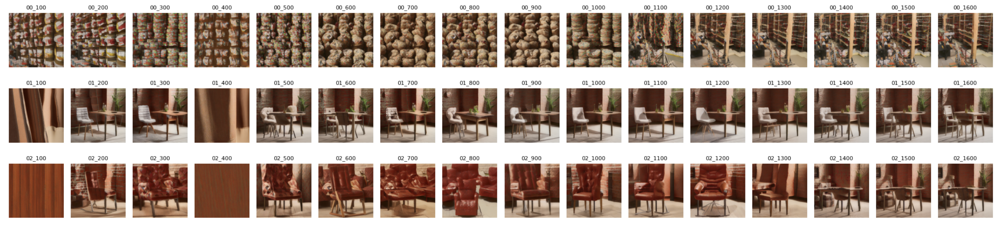

1. For the first image, the model is unable to produce an image of any chair. 
2. The background of the images is not white
3. Examining the last images of the 3rd row, the images seem to fall into the category of the second row, which is unwanted

Maybe these observations will change once it is trained on all images.<br>

Notably, for the second and third image, the produced images already come close (by shape and texture) to the original photos (for the second image, no color is provided in the prompt, such that it is justified, the chair is not blue). <br>

Here again the original images: <br>
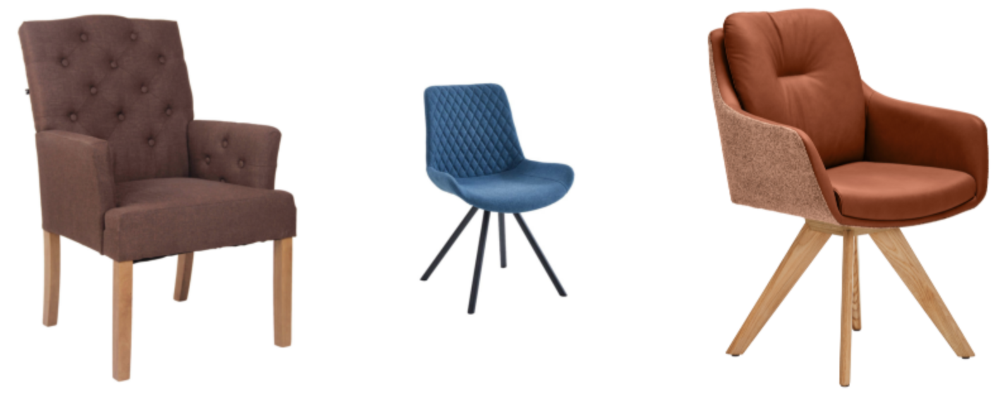

Seeing how the model already produces images faithful to the intention /  the chair distribution, we reduce the learning rate for the real training to avoid gradient steps too large on single images. <br>
It is trained approximately on 25 times as many images. The model gives best results between step 1000 and 1200. <br><br>

Therefore, we decrease the learning rate to 1/5 of the original learning rate (now 1e-6). Since a model is saved every epoch, we can chose a checkpoint where images are the best.<br><br>




An increased batch size of two would be feasible but would require recomputing of the latents (because the aspect ration bucketing code takes into account the batch size). Therefore it is kept at one.

In [6]:
import traceback
import pandas as pd
from tensorboard.backend.event_processing.event_accumulator import EventAccumulator

def tflog2pandas(path):
    runlog_data = pd.DataFrame({"metric": [], "value": [], "step": []})
    try:
        event_acc = EventAccumulator(path)
        event_acc.Reload()
        tags = event_acc.Tags()["scalars"]
        for tag in tags:
            event_list = event_acc.Scalars(tag)
            values = list(map(lambda x: x.value, event_list))
            step = list(map(lambda x: x.step, event_list))
            r = {"metric": [tag] * len(step), "value": values, "step": step}
            r = pd.DataFrame(r)
            runlog_data = pd.concat([runlog_data, r])

    except Exception:
        print("Event file possibly corrupt: {}".format(path))
        traceback.print_exc()
    
    return runlog_data

dfs = []
import os 
last_ep, last_step = 0, 0
for p in list(sorted(os.listdir('loss'))):
    df=tflog2pandas("loss/"+p)
    delta = last_step- df.loc[df['metric'] == 'loss','step'].min()  +1
    df.loc[df['metric'] == 'loss','step'] += delta
    df.loc[df['metric'] == 'loss/epoch', 'step'] += last_ep
    last_ep = df[df['metric'] == 'loss/epoch']['step'].max()
    last_step = df[df['metric'] == 'loss']['step'].max()
    
    dfs.append(df)

df = pd.concat(dfs)

import matplotlib.pyplot as plt



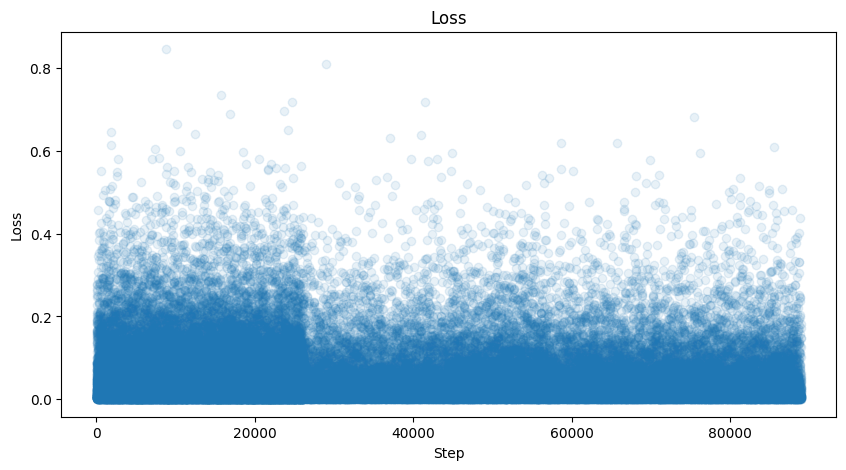

In [61]:
plt.figure(figsize=(10, 5))
plt.scatter(df[df['metric']=='loss']['step'], df[df['metric']=='loss']['value'], alpha=0.1)
plt.title('Loss')
plt.xlabel('Step')
plt.ylabel('Loss')
plt.show()


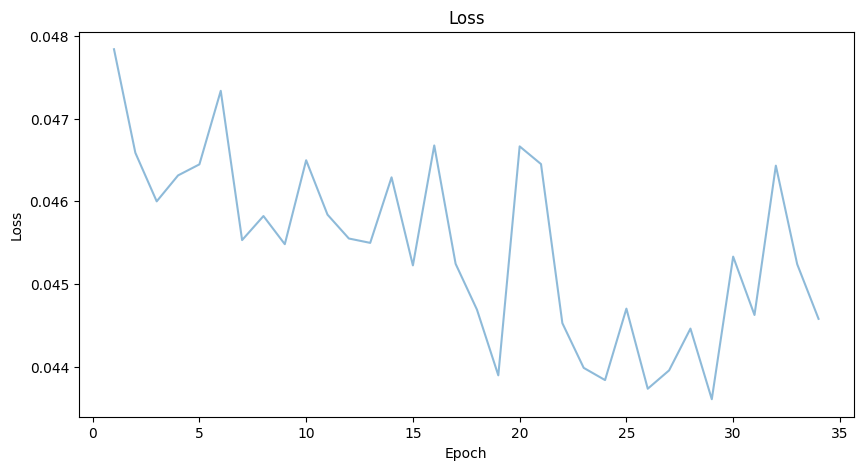

In [7]:
plt.figure(figsize=(10, 5))
plt.plot(df[df['metric']=='loss/epoch']['step'], df[df['metric']=='loss/epoch']['value'], alpha=0.5)
plt.title('Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.show()



In [73]:
df[(True)&(df['metric']=='loss/epoch')]

,metric,value,step
0,loss/epoch,0.047839,1.0
1,loss/epoch,0.046587,2.0
0,loss/epoch,0.046000,3.0
1,loss/epoch,0.046313,4.0
0,loss/epoch,0.046447,5.0
1,loss/epoch,0.047336,6.0
0,loss/epoch,0.045532,7.0
1,loss/epoch,0.045822,8.0
0,loss/epoch,0.045482,9.0
1,loss/epoch,0.046497,10.0


## Comparing Models
Here we compare results from SD 1.5. versus the finetuned model of epoch 34.

In [19]:
# this code is adapted from https://github.com/Linaqruf/kohya-trainer/
import os
from diffusers.utils import logging

logging.set_verbosity_error() 

def create_img(prompt, model, seed=4):
    v2 = False  # @param {type:"boolean"}
    v_parameterization = False  # @param {type:"boolean"}

    negative = ""
    #negative = "lowres, bad anatomy, bad hands, text, error, missing fingers, extra digit, fewer digits, cropped, worst quality, low quality, normal quality, jpeg artifacts, signature, watermark, username, blurry"  # @param {type: "string"}
    #model = ""  # @param {type: "string"}
    vae = ""  # @param {type: "string"}
    outdir = "tmp"  # @param {type: "string"}
    scale = 7  # @param {type: "slider", min: 1, max: 40}
    sampler = "ddim"  # @param ["ddim", "pndm", "lms", "euler", "euler_a", "heun", "dpm_2", "dpm_2_a", "dpmsolver","dpmsolver++", "dpmsingle", "k_lms", "k_euler", "k_euler_a", "k_dpm_2", "k_dpm_2_a"]
    steps = 45  # @param {type: "slider", min: 1, max: 100}
    precision = "fp16"  # @param ["fp16", "bf16"] {allow-input: false}
    width = 512  # @param {type: "integer"}
    height = 512  # @param {type: "integer"}
    images_per_prompt = 1  # @param {type: "integer"}
    batch_size = 1  # @param {type: "integer"}
    clip_skip = 2  # @param {type: "slider", min: 1, max: 40}
    #seed = -1  # @param {type: "integer"}

    final_prompt = f"{prompt} --n {negative}"


    config = {
        "v2": v2,
        "v_parameterization": v_parameterization,
        "ckpt": model,
        "outdir": outdir,
        "xformers": False,
        "vae": vae if vae else None,
        "fp16": True,
        "W": width,
        "H": height,
        "seed": seed if seed > 0 else None,
        "scale": scale,
        "sampler": sampler,
        "steps": steps,
        "max_embeddings_multiples": 3,
        "batch_size": batch_size,
        "images_per_prompt": images_per_prompt,
        "clip_skip": clip_skip if not v2 else None,
        "prompt": final_prompt,
    }

    args = ""
    for k, v in config.items():
        if isinstance(v, str):
            args += f'--{k}="{v}" '
        if isinstance(v, bool) and v:
            args += f"--{k} "
        if isinstance(v, float) and not isinstance(v, bool):
            args += f"--{k}={v} "
        if isinstance(v, int) and not isinstance(v, bool):
            args += f"--{k}={v} "

    final_args = f"python gen_img_diffusers.py {args}"

    #os.chdir(repo_dir)
    os.chdir('sd-scripts')
    !{final_args}
    os.chdir('..')

In [116]:
# Sample prompts
# 1 von fff852e4-140f-53d4-a9be-7f4c6558abf0.jpg
# 2 von fa257c34-6d93-5f57-9b2c-579d8b59890f.jpg
training_sample_prompts = ["""
Preis 150, Breite: 66cm, Hoehe: 98cm, Tiefe: 66cm, Gewicht 11kg, Farbe Dunkelgrau, Technische Details Max. Belastbarkeit 136kg, Produktmerkmale Rueckenlehne Hoehe 49cm, Armlehnen/Armteil Armlehnenhoehe 18cm, Bezug Material Textil, Material Textil, Material Oberflaeche Textil Textilgeflecht, Kundenhinweise Pflegehinweise Keine scharfen Reinigungsmittel verwenden""",

"""Preis 370, Allgemeine Angaben Breite: 56cm, Allgemeine Angaben Hoehe: 86cm, Allgemeine Angaben Tiefe: 59cm, Allgemeine Angaben Gewicht 15kg, Allgemeine Angaben Farbe Braun, Artikel besteht aus Anzahl der Stuehle 2, Technische Details Anzahl der Sitzplaetze 1, Produktmerkmale Bezug Stoffzusammensetzung 100% Polyester, Material Holzwerkstoff""",

"""Preis 499, Allgemeine Angaben Breite: 62cm, Allgemeine Angaben Hoehe: 90cm, Allgemeine Angaben Tiefe: 65cm, Allgemeine Angaben Farbe Haselnussfarben, Allgemeine Angaben Farbe Cognac, Allgemeine Angaben Farbe Wildeiche, Produktvorteile Zubehoer inklusive Armlehnen, Produktvorteile Gestell, Produktvorteile Besonderheiten Lederauswahl, Produktvorteile Stoffauswahl, Produktvorteile Typenauswahl, Produktvorteile inklusive Armlehnen, Produktvorteile Gestellauswahl, Artikel besteht aus Anzahl der Rueckenkissen 1, Artikel besteht aus Rueckenkissen, Technische Details Max. Belastbarkeit 140kg, Armlehnen/Armteil Armlehnenhoehe 66cm, Material Oberflaeche geoelt, Material Lederart Kombination Echtleder/Stoff, Material Lederqualitaet Rindleder, Material Holzart Eiche, Material Holzqualitaet Echtholz, Material Echtholz massiv, Material Scheuertouren 50.000, Material Oberflaeche Leder pigmentiert, Material Lichtechtheit 5 gut, Material Abriebfestigkeit 4 gut, Material Pillingbildung 4 leicht, Material Holz, Material Textil, Material Leder, Material Oberflaeche Textil Webstoff, Material Materialzusammensetzung 100 % Polyester, Beine Farbe Eiche Bianco, Beine Anzahl der Beine 4, Beine Beinform konisch, Beine Stativgestell, Sitzflaeche Sitzbreite 42-47cm, Sitzflaeche Sitzhoehe 48cm, Sitzflaeche Sitztiefe 42cm, Innenleben Rueckenlehne Schaumstoff, Innenleben Schaumstoff, Kundenhinweise Verwendung Indoor, Kundenhinweise Lieferhinweis fuer Endkunden zerlegt, Kundenhinweise Jedes Echtholzprodukt ist ein Unikat. Woelbungen, Kundenhinweise Farbverlaeufe etc. sind warentypisch und stellen keinen Reklamationsgrund dar., Kundenhinweise Transporthinweis fuer Endkunden Kombi, Kundenhinweise Montagehinweis fuer Endkunden handwerkliche Begabung, Kundenhinweise Pflegehinweise Holzpflegemittel verwenden, Kundenhinweise Lederpflegemittel verwenden, Kundenhinweise nebelfeucht wischen, Verpackungsmasse Anzahl der Pakete 2, Verpackungsmasse Paket 1 Laenge: 65cm, Verpackungsmasse Paket 1 Breite: 65cm, Verpackungsmasse Paket 1 Hoehe: 76cm, Verpackungsmasse Paket 2 Laenge: 56cm, Verpackungsmasse Paket 2 Breite: 51cm"""]

    

from diffusers import StableDiffusionPipeline
from library.lpw_stable_diffusion import StableDiffusionLongPromptWeightingPipeline
import torch

pipeline = None
current_pipeline = None

def create_image(prompt, negative_prompt='',seed=4, guidance_scale=5, num_inference_steps=45, which='finetuned'):
    global current_pipeline
    global pipeline
    
    sd15 = 'runwayml/stable-diffusion-v1-5'
    ep34 = '/Users/amos/Programming/Studium/AIML/Chairs/downloaded_models/ep34chair_2024-06-19_09-58-59.safetensors'
    if current_pipeline != which:
        if which=='finetuned':
            pipe0 = StableDiffusionPipeline.from_single_file(ep34)
        else:
            pipe0 = StableDiffusionPipeline.from_pretrained(sd15)

        pipeline = StableDiffusionLongPromptWeightingPipeline(
                text_encoder=pipe0.components['text_encoder'],
                vae=pipe0.components['vae'],
                unet=pipe0.components['unet'],
                tokenizer=pipe0.components['tokenizer'],
                scheduler=pipe0.components['scheduler'],
                safety_checker=None,
                feature_extractor=None,
                requires_safety_checker=False,
                clip_skip=2,
            ).to(torch.float16)
        pipeline.to('mps')
        current_pipeline = which
    
    generator = torch.Generator().manual_seed(seed)

    with torch.no_grad():
        latents = pipeline.text2img(
            prompt=prompt,
            negative_prompt=negative_prompt,
            height=512,
            width=512,
            num_inference_steps=num_inference_steps,
            guidance_scale=guidance_scale,
            generator=generator,
            max_embeddings_multiples=10,

        )
        image = pipeline.latents_to_image(latents)[0]
        

    return image

Using model.to("mps") excerts double the speed of cpu inference. The model can calculate 1.4 steps per second

Notably, the tokenizer throws an error "Length longer than maximum length"... but we verify that this is no problem: The model recognized the last tokens which describe food and generates a corresponding picture:

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

Token indices sequence length is longer than the specified maximum sequence length for this model (140 > 77). Running this sequence through the model will result in indexing errors


  0%|          | 0/31 [00:00<?, ?it/s]

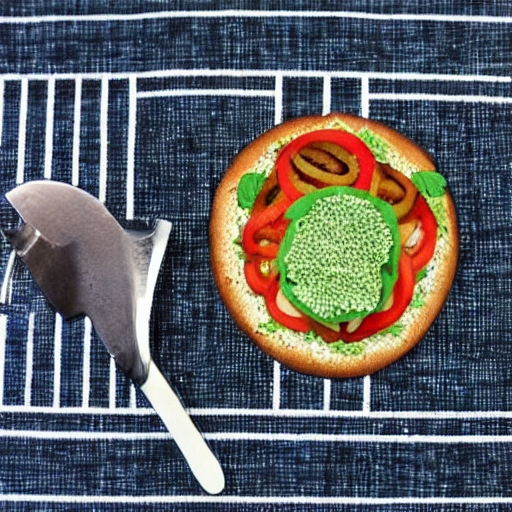

In [34]:
create_image(training_sample_prompts[i]+', (((burger))), pizza, spaghetti, food, eating', which='base', seed=4, guidance_scale=7.5, num_inference_steps=30)

In [4]:
from tqdm.auto import tqdm
base_images, finetuned_images = [], []
for model in ['','finetuned']:
    for i in tqdm(range(3)):
        image = create_image(training_sample_prompts[i], which=model, seed=4, guidance_scale=7.5, num_inference_steps=30)
        if model == '':
            base_images.append(image)
        else:
            finetuned_images.append(image)
        break

  0%|          | 0/3 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

Token indices sequence length is longer than the specified maximum sequence length for this model (142 > 77). Running this sequence through the model will result in indexing errors
/Users/amos/Programming/Studium/AIML/Chairs/kohya_ss/sd-scripts/library/lpw_stable_diffusion.py:688: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  self.unet.in_channels,


  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

In this conversion only the non-EMA weights are extracted. If you want to instead extract the EMA weights (usually better for inference), please make sure to add the `--extract_ema` flag.
/Users/amos/miniconda3/envs/sd-scripts/lib/python3.10/site-packages/torch/_utils.py:831: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  return self.fget.__get__(instance, owner)()
/Users/amos/miniconda3/envs/sd-scripts/lib/python3.10/site-packages/transformers/models/clip/feature_extraction_clip.py:28: FutureWarning: The class CLIPFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use CLIPImageProcessor instead.
  warnings.warn(
Token indices sequence length is longer than the specified maximum sequence length for this model (142

  0%|          | 0/31 [00:00<?, ?it/s]

Different seed:

Base SD 1.5. Model:


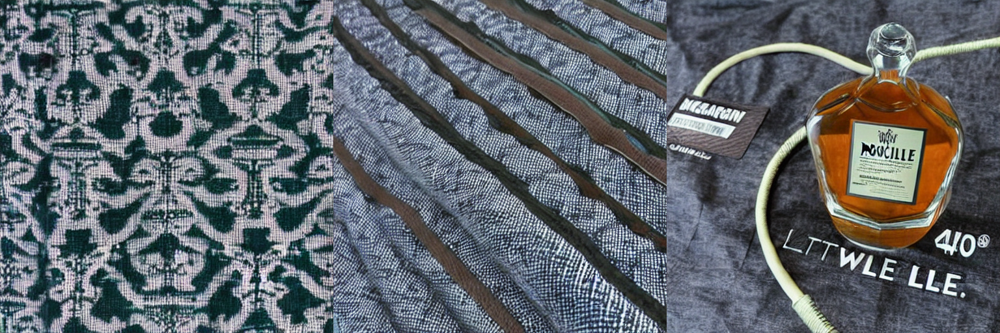

Finetuned Model:


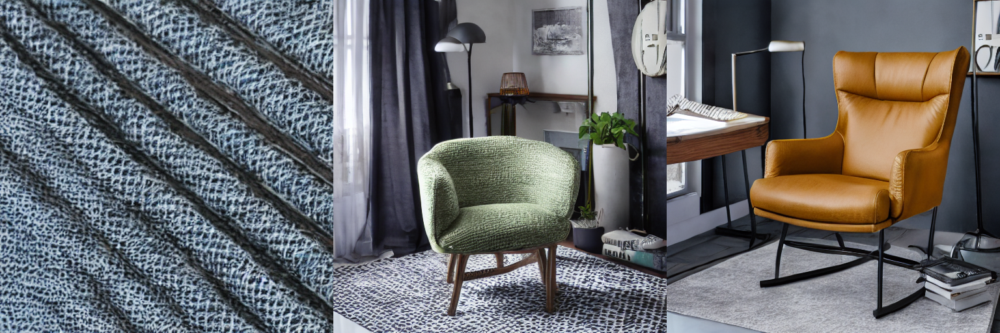

In [23]:
from PIL import Image
import numpy as np

image_arrays = [np.array(image) for image in base_images]
horizontal_stack = np.hstack(image_arrays)
horizontal_image = Image.fromarray(horizontal_stack)
print('Base SD 1.5. Model:')
display(horizontal_image)
print('Finetuned Model:')
display(Image.fromarray(np.hstack([np.array(image) for image in finetuned_images])))

We are unsure, why the produced images differ from what is computed during training as validation images, and tried different approaches to resolve the issue. The same code as in the original script is used for inference, however we did not check the exact settings.

One mistake was made during trainig: We assumed the max_token_length to correpond to number of words. Therefore for some prompts, the text is cut off during training (A larger value for the parameter should have been set, instead of 225). Using prompt shuffeling possibliy mitigates the issue, since all tokens have had a chance to be part of a training pair.


To examine the criteria from before (we are unable to set the correct configuration to reproduce the validation setup):
1. For the first image, the model is unable to produce an image of any chair. 
-> The model did not resolve this issue.
2. The background of the images is not white
-> The background of images with different seed is not white
3. Examining the last images of the 3rd row, the images seem to fall into the category of the second row, which is unwanted


However we find that the model shows some signs of finetuning as for the same image prompts and random seed, the finetuned model produces chairs in 2/3 cases whereas the original SD 1.5. Model creates arbitrary images (as is expected, since the prompt does not contain the word "chair").
Interestingly for the original random seed, the model does not create images of chairs, but the fabric has wooden chair legs on the bottom:

Base SD 1.5. Model:


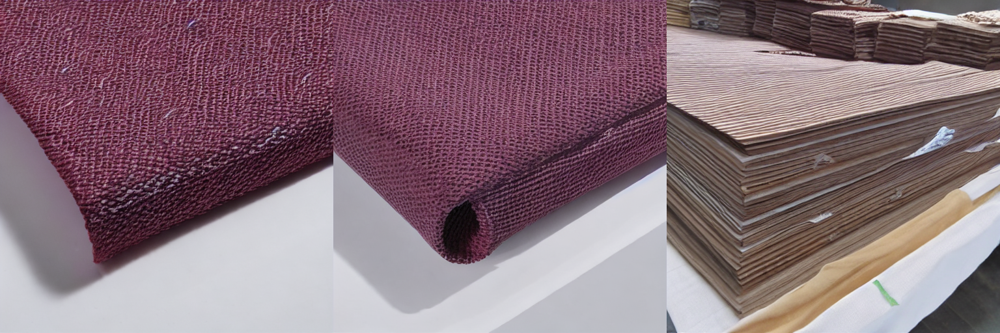

Finetuned Model:


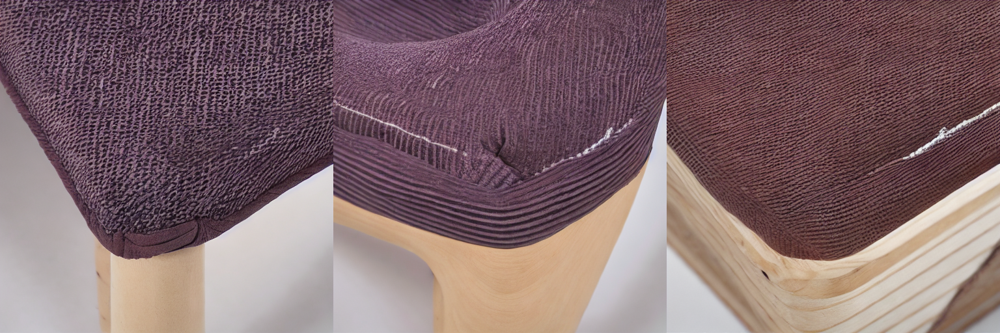

In [8]:
print('Base SD 1.5. Model:')
display(Image.fromarray(np.hstack([np.array(image) for image in base_images])))
print('Finetuned Model:')
display(Image.fromarray(np.hstack([np.array(image) for image in finetuned_images])))

### Testing prompt adherence and dimensions

In [8]:
materialien = ['Material Metal', 'Material Polyester', 'Material Eiche', 'Material Buche', 'Material Bambus','Material Leder']
steppart = ['Allgemeine Angaben Web-/Druckart beschichtet', 'Allgemeine Angaben Web-/Druckart gesteppt', 'Allgemeine Angaben Web-/Druckart geflochten', 'Allgemeine Angaben Web-/Druckart beflockt']

merkmale = ['Produktvorteile Sitzflaeche 360grad drehbar, Technische Details Sitzflaeche drehbar Ja']
belastbarkeit = ['Technische Details Max. Belastbarkeit 5kg','Technische Details Max. Belastbarkeit 20kg','Technische Details Max. Belastbarkeit 140kg','Technische Details Max. Belastbarkeit 1000kg']

hoehe = [' Allgemeine Angaben Hoehe: 10cm',' Allgemeine Angaben Hoehe: 200cm']
armlehnen = ['Produktmerkmale Rueckenlehne Hoehe 32cm' 'Armlehnen/Armteil Armlehnenhoehe 1cm']

beinform = ['Beine Beinform eckig', 'Beine Beinform Rundrohr','Beine Beinform konisch', 'Beine Beinform Kufe', 'Beine Beinform Stativgestell']
beinanzahl = ['Beine Anzahl der Beine 1', 'Beine Anzahl der Beine 2','Beine Anzahl der Beine 3', 'Beine Anzahl der Beine 10']

variations = [(materialien, 'Material'), (steppart, 'Steppart'), (merkmale, 'Merkmale'), (belastbarkeit, 'Belastbarkeit'), (hoehe, 'hoehe'), (armlehnen, 'Armlehnen'), (beinform, 'Beinform'), (beinanzahl, 'Beinanzahl')]

===> Variation: Material


/Users/amos/Programming/Studium/AIML/Chairs/kohya_ss/sd-scripts/library/lpw_stable_diffusion.py:688: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  self.unet.in_channels,


  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

Material Metal   Material Polyester   Material Eiche   Material Buche   Material Bambus   Material Leder


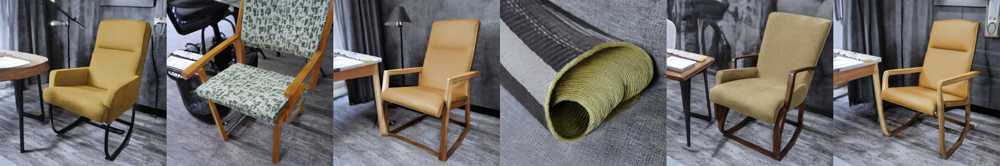

Prompt was truncated. Try to shorten the prompt or increase max_embeddings_multiples


===> Variation: Steppart


  0%|          | 0/31 [00:00<?, ?it/s]

Prompt was truncated. Try to shorten the prompt or increase max_embeddings_multiples


  0%|          | 0/31 [00:00<?, ?it/s]

Prompt was truncated. Try to shorten the prompt or increase max_embeddings_multiples


  0%|          | 0/31 [00:00<?, ?it/s]

Prompt was truncated. Try to shorten the prompt or increase max_embeddings_multiples


  0%|          | 0/31 [00:00<?, ?it/s]

Allgemeine Angaben Web-/Druckart beschichtet   Allgemeine Angaben Web-/Druckart gesteppt   Allgemeine Angaben Web-/Druckart geflochten   Allgemeine Angaben Web-/Druckart beflockt


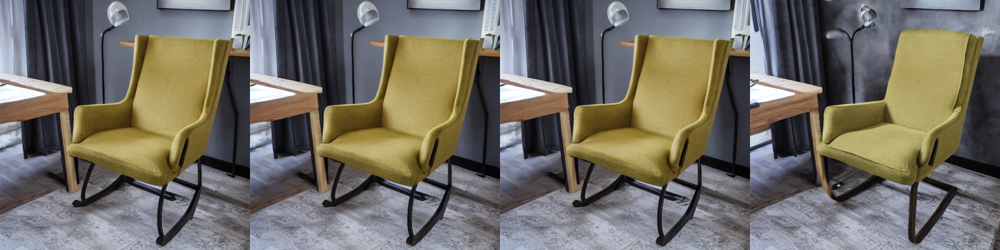

Prompt was truncated. Try to shorten the prompt or increase max_embeddings_multiples


===> Variation: Merkmale


  0%|          | 0/31 [00:00<?, ?it/s]

Produktvorteile Sitzflaeche 360grad drehbar, Technische Details Sitzflaeche drehbar Ja


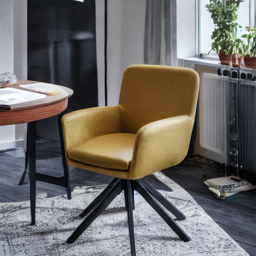

Prompt was truncated. Try to shorten the prompt or increase max_embeddings_multiples


===> Variation: Belastbarkeit


  0%|          | 0/31 [00:00<?, ?it/s]

Prompt was truncated. Try to shorten the prompt or increase max_embeddings_multiples


  0%|          | 0/31 [00:00<?, ?it/s]

Prompt was truncated. Try to shorten the prompt or increase max_embeddings_multiples


  0%|          | 0/31 [00:00<?, ?it/s]

Prompt was truncated. Try to shorten the prompt or increase max_embeddings_multiples


  0%|          | 0/31 [00:00<?, ?it/s]

Technische Details Max. Belastbarkeit 5kg   Technische Details Max. Belastbarkeit 20kg   Technische Details Max. Belastbarkeit 140kg   Technische Details Max. Belastbarkeit 1000kg


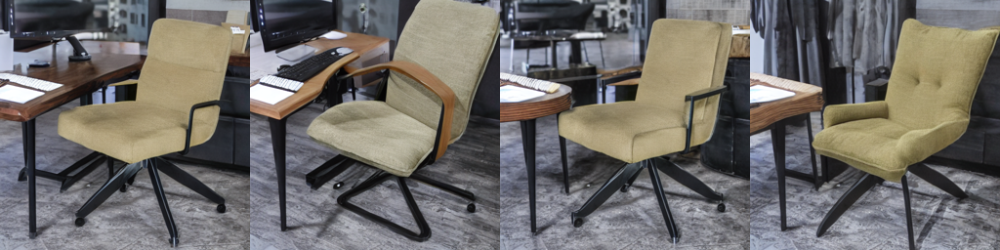

Prompt was truncated. Try to shorten the prompt or increase max_embeddings_multiples


===> Variation: Breite


  0%|          | 0/31 [00:00<?, ?it/s]

Prompt was truncated. Try to shorten the prompt or increase max_embeddings_multiples


  0%|          | 0/31 [00:00<?, ?it/s]

 Allgemeine Angaben Hoehe: 10cm    Allgemeine Angaben Hoehe: 200cm


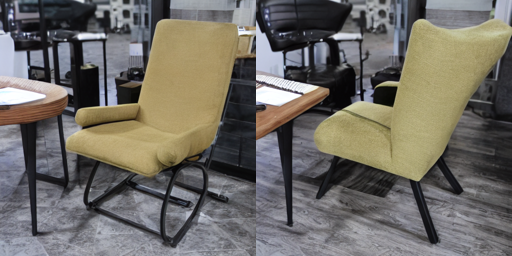

Prompt was truncated. Try to shorten the prompt or increase max_embeddings_multiples


===> Variation: Armlehnen


  0%|          | 0/31 [00:00<?, ?it/s]

Produktmerkmale Rueckenlehne Hoehe 32cmArmlehnen/Armteil Armlehnenhoehe 1cm


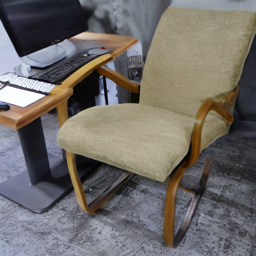

===> Variation: Beinform


  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

Beine Beinform eckig   Beine Beinform Rundrohr   Beine Beinform konisch   Beine Beinform Kufe   Beine Beinform Stativgestell


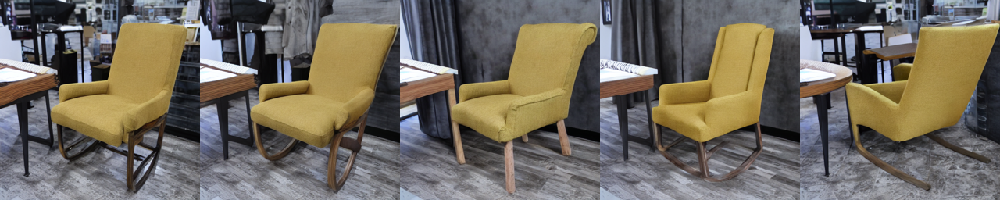

===> Variation: Beinanzahl


  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

  0%|          | 0/31 [00:00<?, ?it/s]

Prompt was truncated. Try to shorten the prompt or increase max_embeddings_multiples


  0%|          | 0/31 [00:00<?, ?it/s]

Beine Anzahl der Beine 1   Beine Anzahl der Beine 2   Beine Anzahl der Beine 3   Beine Anzahl der Beine 10


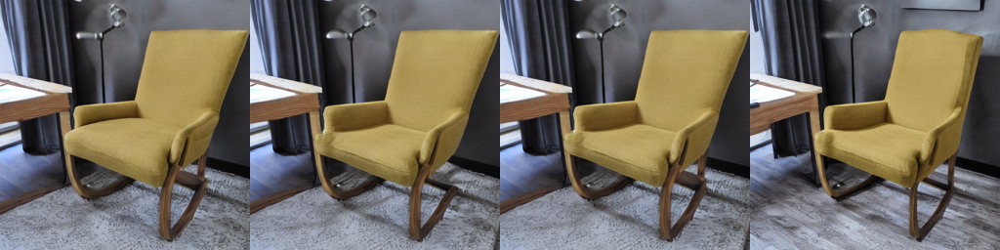

In [15]:
for variation in variations:
    print(f'===> Variation: {variation[1]}')
    images = []
    for kind in variation[0]:
        # print(f'{kind}')
        image = create_image('((('+kind+'))),'+training_sample_prompts[2], which='finetuned', seed=4, guidance_scale=7.5, num_inference_steps=30)
        if variation[1] == 'Steppart':
            pass
        else:
            image = image.resize((256, 256))
        images.append(image)
    print('   '.join(variation[0]))
    display(Image.fromarray(np.hstack([np.array(image) for image in images])))

### More examples

In this conversion only the non-EMA weights are extracted. If you want to instead extract the EMA weights (usually better for inference), please make sure to add the `--extract_ema` flag.


  0%|          | 0/25 [00:00<?, ?it/s]

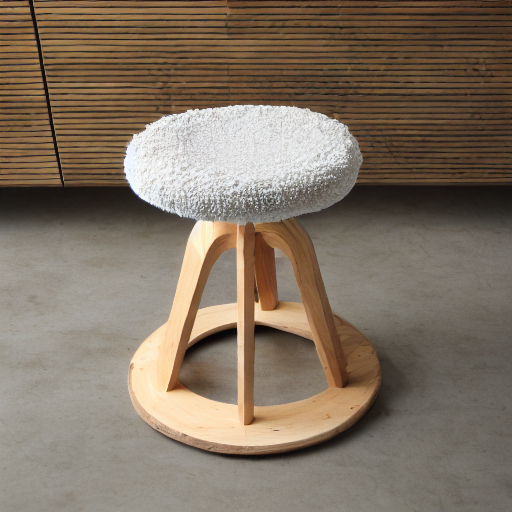

In [74]:
create_image("Stuhl, Preis: 100, Allgemeine Angaben Breite: 50cm, Allgemeine Angaben Hoehe: 100cm, Allgemeine Angaben Tiefe: 51cm, (((Produktvorteile Sitzflaeche 360grad drehbar))), (((Technische Details Sitzflaeche drehbar Ja))), (Material Holzart Eukalyptusholz), (Material Holzqualitaet Echtholz),  Material Echtholz massiv, Material Sperrholz", which='finetuned', seed=14, guidance_scale=12, num_inference_steps=24)

Using base model

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

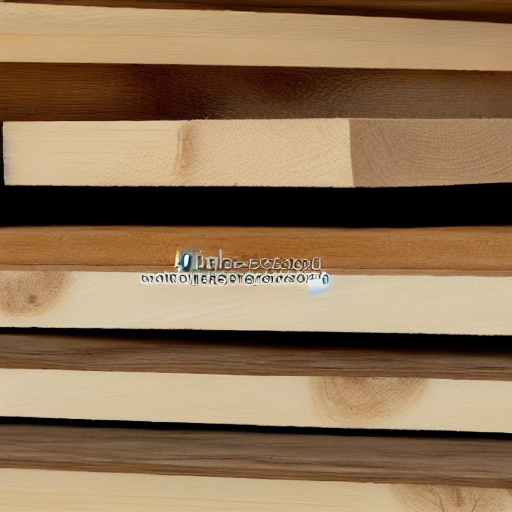

In [75]:
create_image("Stuhl, Preis: 100, Allgemeine Angaben Breite: 50cm, Allgemeine Angaben Hoehe: 100cm, Allgemeine Angaben Tiefe: 51cm, (((Produktvorteile Sitzflaeche 360grad drehbar))), (((Technische Details Sitzflaeche drehbar Ja))), (Material Holzart Eukalyptusholz), (Material Holzqualitaet Echtholz),  Material Echtholz massiv, Material Sperrholz", which='base', seed=14, guidance_scale=12, num_inference_steps=24)

More examples

In this conversion only the non-EMA weights are extracted. If you want to instead extract the EMA weights (usually better for inference), please make sure to add the `--extract_ema` flag.


  0%|          | 0/25 [00:00<?, ?it/s]

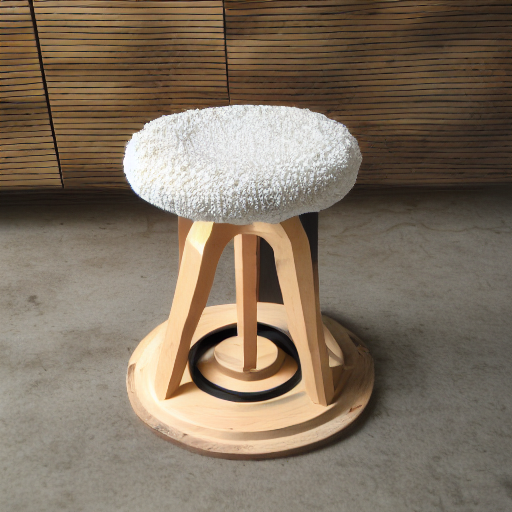

In [76]:
create_image("Stuhl, Preis: 100, Allgemeine Angaben Breite: 50cm, Allgemeine Angaben Hoehe: 100cm, Allgemeine Angaben Tiefe: 51cm, (((Produktvorteile Sitzflaeche 360grad drehbar))), (((Technische Details Sitzflaeche drehbar Ja))), (Material Holzart Eiche), (Material Holzqualitaet Echtholz),  Material Echtholz massiv, Material Sperrholz", which='finetuned', seed=14, guidance_scale=12, num_inference_steps=24)

  0%|          | 0/25 [00:00<?, ?it/s]

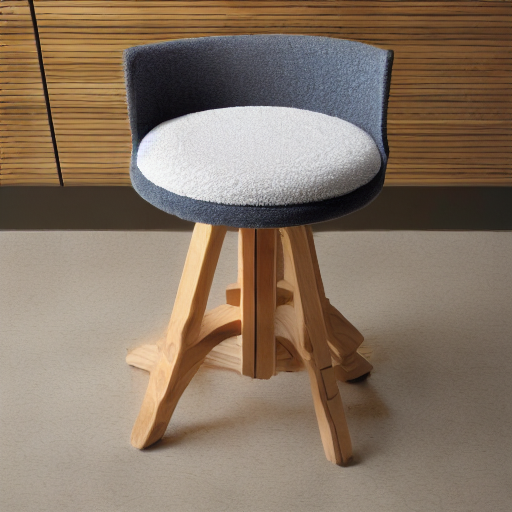

In [77]:
create_image("Stuhl, Preis: 100, Allgemeine Angaben Breite: 50cm, Allgemeine Angaben Hoehe: 100cm, Allgemeine Angaben Tiefe: 51cm, (((Produktvorteile Sitzflaeche 360grad drehbar))), (((Technische Details Sitzflaeche drehbar Ja))), (Innenleben Schaumstoff), (Material Holzart Eukalyptusholz), (Material Holzqualitaet Echtholz),  Material Echtholz massiv, Material Sperrholz", which='finetuned', seed=14, guidance_scale=12, num_inference_steps=24)

  0%|          | 0/26 [00:00<?, ?it/s]

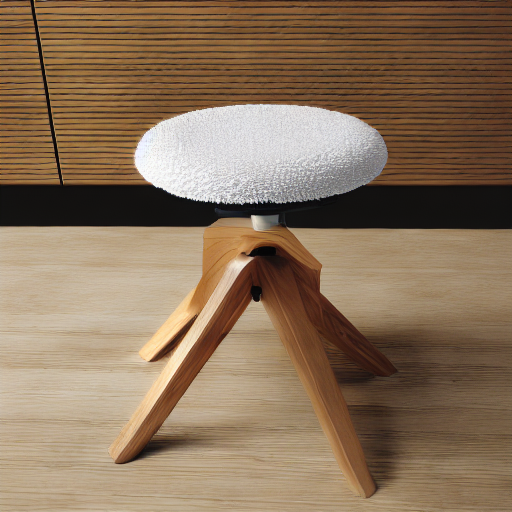

In [86]:
create_image("Stuhl, Preis: 100, Allgemeine Angaben Breite: 50cm, Allgemeine Angaben Hoehe: 100cm, Allgemeine Angaben Tiefe: 51cm, (((Produktvorteile Sitzflaeche 360grad drehbar))), (((Technische Details Sitzflaeche drehbar Ja))), (Innenleben Schaumstoff), (Material Holzart Eukalyptusholz), (Material Holzqualitaet Echtholz),  Material Echtholz massiv, Material Sperrholz, Material Lichtechtheit 5 gut, Material Abriebfestigkeit 4 gut, Produktvorteile Zertifikate/Pruefzeichen EMAS, Produktvorteile DGM", which='finetuned', seed=14, guidance_scale=12, num_inference_steps=25)

  0%|          | 0/21 [00:00<?, ?it/s]

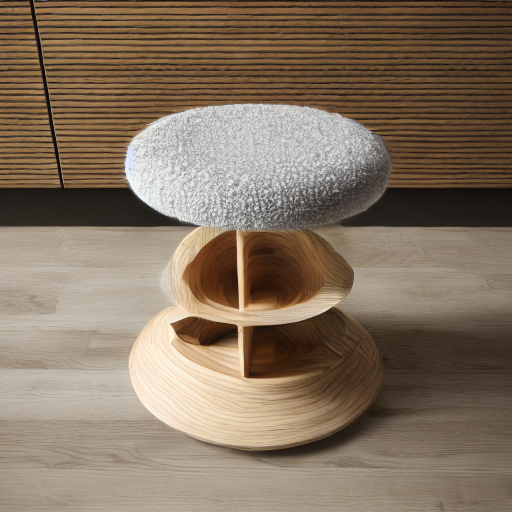

In [89]:
create_image("Stuhl, Preis: 100, Allgemeine Angaben Breite: 50cm, Allgemeine Angaben Hoehe: 100cm, Allgemeine Angaben Tiefe: 51cm, (((Produktvorteile Sitzflaeche 360grad drehbar))), (((Technische Details Sitzflaeche drehbar Ja))), (Innenleben Schaumstoff), (Material Holzart Eukalyptusholz), (Material Holzqualitaet Echtholz),  Material Echtholz massiv, Material Sperrholz, Material Lichtechtheit 5 gut, Material Abriebfestigkeit 4 gut", which='finetuned', seed=14, guidance_scale=12, num_inference_steps=20)

  0%|          | 0/25 [00:00<?, ?it/s]

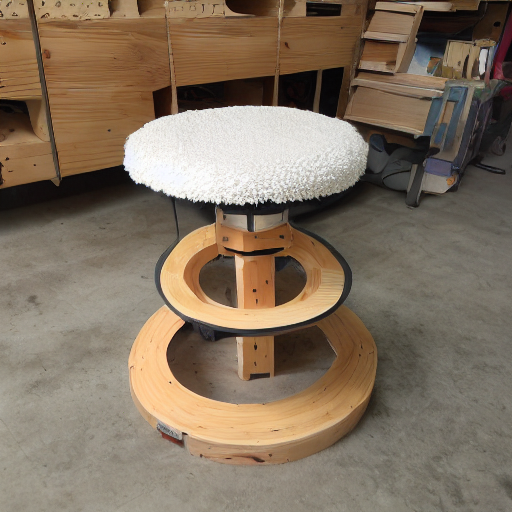

In [104]:
create_image("Stuhl, Preis: 100, Allgemeine Angaben Breite: 50cm, Allgemeine Angaben Hoehe: 100cm, Allgemeine Angaben Tiefe: 51cm, (((Produktvorteile Sitzflaeche 360grad drehbar))), (((Technische Details Sitzflaeche drehbar Ja))), (Innenleben Schaumstoff), (Material Holzart Eukalyptusholz), (Material Holzqualitaet Echtholz),  Material Echtholz massiv, Material Sperrholz, ((Produktmerkmale Materialzusammensetzung Bezug Stoff/Textil 80% Baumwolle und 20% Polyester))", negative_prompt="Innenleben Schaumstoff, (((Kundenhinweise Jedes Fellprodukt ist ein Unikat))))", which='finetuned', seed=14, guidance_scale=12, num_inference_steps=24)

### Baseline
Here we try to create images of chairs by finding the correct prompting for the base Stable Diffusion 1.5 model.

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

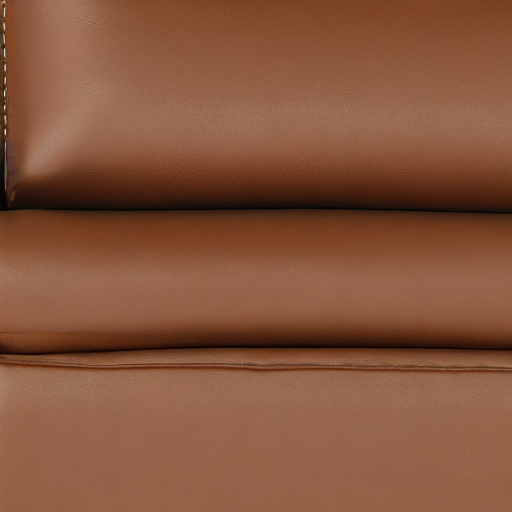

In [118]:
create_image("Product image of chair, armrest, leather", which='baseline', seed=14, guidance_scale=12, num_inference_steps=24)

  0%|          | 0/25 [00:00<?, ?it/s]

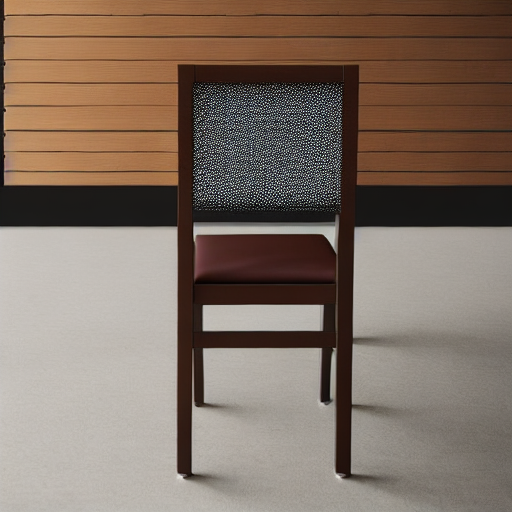

In [119]:
create_image("Product image of chair, dining chair, stock photo, product photo, armrest, leather", which='baseline', seed=14, guidance_scale=12, num_inference_steps=24)

  0%|          | 0/25 [00:00<?, ?it/s]

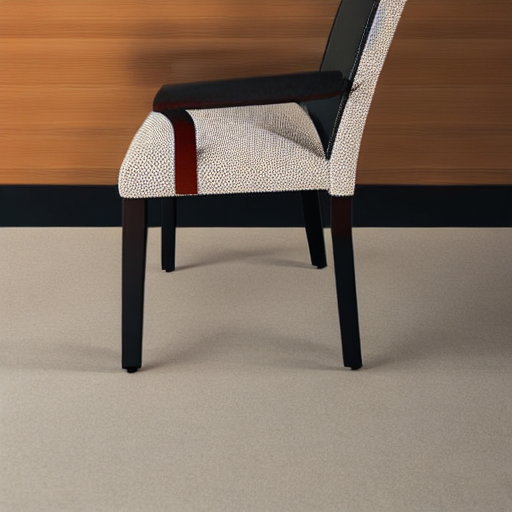

In [120]:
create_image("Product image of chair, dining chair, stock photo, product photo, armrest, leather, frontal view", which='baseline', seed=14, guidance_scale=12, num_inference_steps=24)

  0%|          | 0/25 [00:00<?, ?it/s]

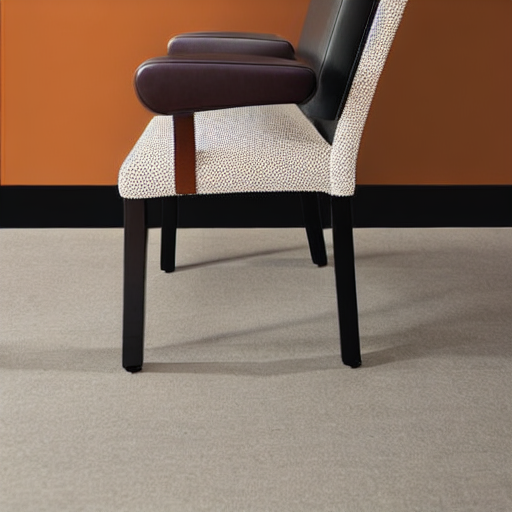

In [121]:
create_image("Product image of chair, dining chair, stock photo, ((product photo)), armrest, leather, frontal view", which='baseline', seed=14, guidance_scale=12, num_inference_steps=24)

  0%|          | 0/25 [00:00<?, ?it/s]

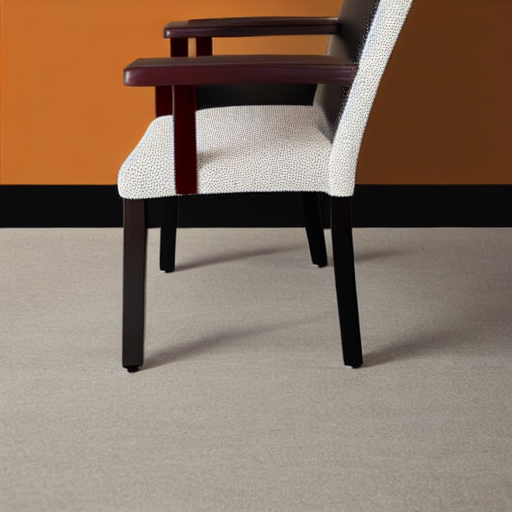

In [122]:
create_image("Product image of chair, dining chair, stock photo, ((product photo)), armrest, leather, ((frontal view))", which='baseline', seed=14, guidance_scale=12, num_inference_steps=24)

# Conclusion
In this notebook, a Stable Diffusion model is finetuned on a scraped dataset which consists of chairs and their text descriptions. Finetuning is successful in the sense that the finetuned model, in contrast to the base model, creates chairs easily when supplied with (german) text it has been finetuned on. 


## Improvements

Interestingly, the model did not learn to always produce a white background, although almost all finetuning images contained a white background.
Perhaps longer training or including keywords could fix this issue.


While experimenting with the prompts we find that the model produces "out of chair-distritbution images" when it is supplied with contradicting text snippets. Therefore, we conclude that more training data (>>6000) could help the model to generalize concepts like materials, heights, widths, sturdiness etc. 

More detailed preprocessing and cleaning of the captions could also avoid prompt ambiguity and redundancy and increase the model's quality.
